Contents

01 Import Libraries and Data
02 Check Output and Clean
03 Create Correlation Heatmap
04 Create Scatterplots for Stronger Correlations
05 Create Pair Plot for Full Dataset
06 Create Categorical Plot
07 Answer Exploration Questions
08 Develop Preliminary Hypotheses and Export File

01 Import Libraries and Data

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import os

In [3]:
matplotlib.__version__

'3.8.4'

In [4]:
# Run command that ensures inline display

%matplotlib inline

In [5]:
# Define path

path = '/Users/Owner/Documents/CareerFoundry/Data Immersion/Achievement 6'

In [6]:
# Import data

df = pd.read_csv(os.path.join(path, 'Depression Data.csv'))

02 Check Output and Clean

In [8]:
df.shape

(6468, 27)

In [9]:
#check column names

df.columns

Index(['Entity', 'Code', 'Year', 'Country, Year', 'Schizophrenia (%)',
       'Bipolar disorder (%)', 'Eating disorders (%)', 'Anxiety disorders (%)',
       'Drug use disorders (%)', 'Depression (%)', 'Alcohol use disorders (%)',
       'All Ages', 'Age 10-14', 'Age 15-19', 'Age 20-24', 'Age 25-29',
       'Age 30-34', 'Age 50-69', 'Age 70+', 'Age 15-49', 'Age Standardized',
       'Prevalence in Males', 'Prevalence in Females', 'Population',
       'Suicide rate (deaths per 100,000 individuals)',
       'Depressive disorder rates (number suffering per 100,000)',
       'Number with depression'],
      dtype='object')

In [10]:
#Rename columns for clarity

df.rename(columns = {'Schizophrenia (%)' : 'Schizophrenia_percent', 'Bipolar disorder (%)' : 'Bipolar_percent', 'Eating disorders (%)' : 'Eating_percent', 'Anxiety disorders (%)' : 'Anxiety_percent', 'Drug use disorders (%)' : 'Drug_percent', 'Depression (%)' : 'Depression_percent', 'Alcohol use disorders (%)' : 'Alcohol_percent', 'Prevalence in Males' : 'Males_percent' , 'Prevalence in Females' : 'Females_percent', 'Suicide rate (deaths per 100,000 individuals)' : 'Suicide_deaths_per_100K', 'Depressive disorder rates (number suffering per 100,000)' : 'Depression_per_100K'}, inplace = True)

In [11]:
#Check output

df.dtypes

Entity                      object
Code                        object
Year                         int64
Country, Year               object
Schizophrenia_percent      float64
Bipolar_percent            float64
Eating_percent             float64
Anxiety_percent            float64
Drug_percent               float64
Depression_percent         float64
Alcohol_percent            float64
All Ages                   float64
Age 10-14                  float64
Age 15-19                  float64
Age 20-24                  float64
Age 25-29                  float64
Age 30-34                  float64
Age 50-69                  float64
Age 70+                    float64
Age 15-49                  float64
Age Standardized           float64
Males_percent              float64
Females_percent            float64
Population                   int64
Suicide_deaths_per_100K    float64
Depression_per_100K        float64
Number with depression     float64
dtype: object

03 Create Correlation Heatmap

In [13]:
# Create a subset suitable for correlation

sub = df[['Schizophrenia_percent', 'Bipolar_percent', 'Eating_percent', 'Anxiety_percent', 'Drug_percent', 'Depression_percent', 'Alcohol_percent', 'Suicide_deaths_per_100K']]

In [14]:
sub

,Schizophrenia_percent,Bipolar_percent,Eating_percent,Anxiety_percent,Drug_percent,Depression_percent,Alcohol_percent,Suicide_deaths_per_100K
0,0.160560,0.697779,0.101855,4.828830,1.677082,4.071831,0.672404,10.318504
1,0.160312,0.697961,0.099313,4.829740,1.684746,4.079531,0.671768,10.327010
2,0.160135,0.698107,0.096692,4.831108,1.694334,4.088358,0.670644,10.271411
3,0.160037,0.698257,0.094336,4.830864,1.705320,4.096190,0.669738,10.376123
4,0.160022,0.698469,0.092439,4.829423,1.716069,4.099582,0.669260,10.575915
...,...,...,...,...,...,...,...,...
6463,0.155670,0.607993,0.117248,3.090168,0.766280,3.128192,1.515641,28.361200
6464,0.155993,0.608610,0.118073,3.093964,0.768914,3.140290,1.515470,27.605547
6465,0.156465,0.609363,0.119470,3.098687,0.771802,3.155710,1.514751,27.197061
6466,0.157111,0.610234,0.121456,3.104294,0.772275,3.174134,1.513269,26.839591


In [15]:
#Create corelation matrix on subset

sub.corr()

,Schizophrenia_percent,Bipolar_percent,Eating_percent,Anxiety_percent,Drug_percent,Depression_percent,Alcohol_percent,Suicide_deaths_per_100K
Schizophrenia_percent,1.000000,0.198456,0.668816,0.469325,0.475203,0.167478,-0.059207,-0.023763
Bipolar_percent,0.198456,1.000000,0.708055,0.663745,0.363871,0.148557,0.079694,-0.270235
Eating_percent,0.668816,0.708055,1.000000,0.698026,0.494187,0.240716,0.035254,-0.085792
Anxiety_percent,0.469325,0.663745,0.698026,1.000000,0.616077,0.379012,-0.136502,-0.155243
Drug_percent,0.475203,0.363871,0.494187,0.616077,1.000000,0.366539,-0.113245,-0.084534
Depression_percent,0.167478,0.148557,0.240716,0.379012,0.366539,1.000000,0.050146,0.380101
Alcohol_percent,-0.059207,0.079694,0.035254,-0.136502,-0.113245,0.050146,1.000000,0.480140
Suicide_deaths_per_100K,-0.023763,-0.270235,-0.085792,-0.155243,-0.084534,0.380101,0.480140,1.000000


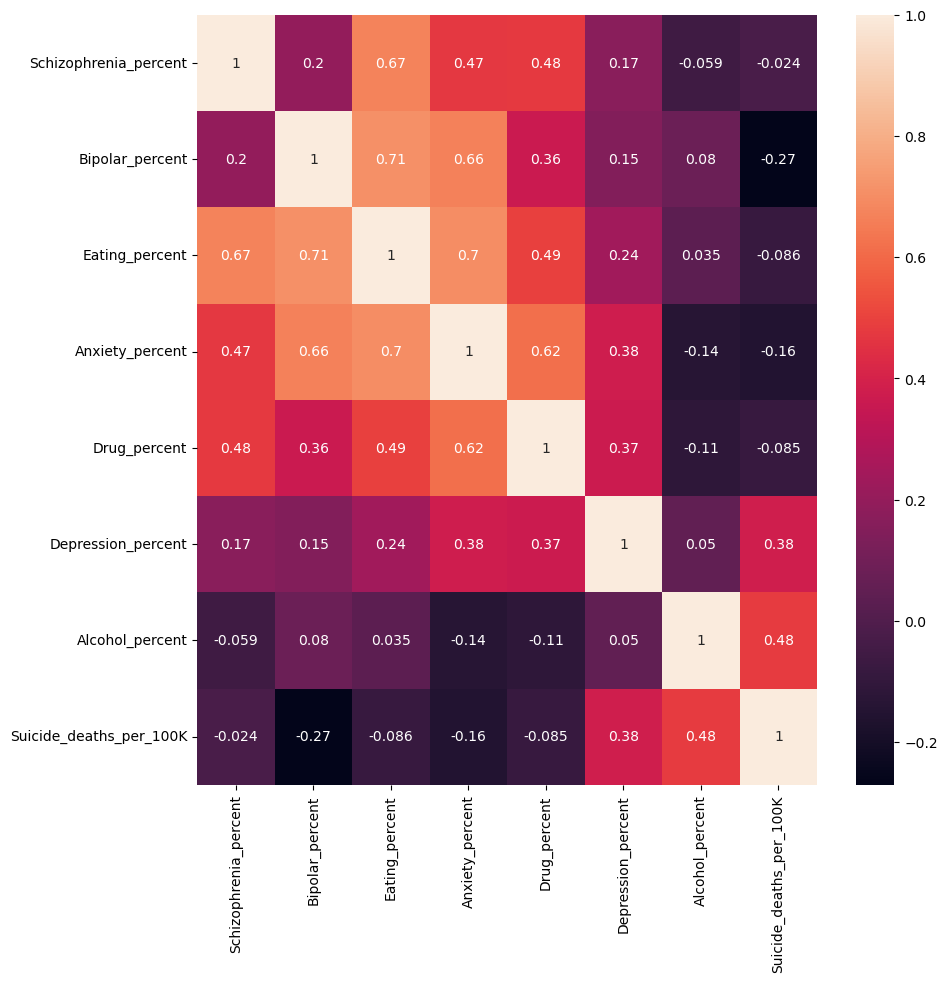

In [16]:
# Create a subplot with matplotlib
f,ax = plt.subplots(figsize=(10,10))

# Create the correlation heatmap in seaborn by applying a heatmap onto the correlation matrix and the subplots defined above.
corr = sns.heatmap(sub.corr(), annot = True, ax = ax)

INSIGHTS: Correlations are weak between mental illnesses and suicide rates. Correlations between depression and other mental illnesses is also weak. The strongest connections are between eating disorder rates and anxiety rates (0.7) and eating disorder and bipolar rates (0.71).Correlation is less strong but still significant with eating disorders and schizophrenia (0.67). Eating disorders seem to have the highest rates of comorbidity.

04 Create Scatterplots for Stronger Correlations

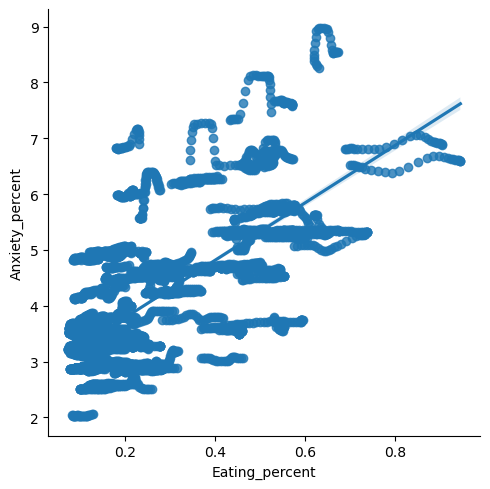

In [19]:
# Create scatterplot for eating disorder and anxiety columns in seaborn

sns.lmplot(x = 'Eating_percent', y = 'Anxiety_percent', data = df)

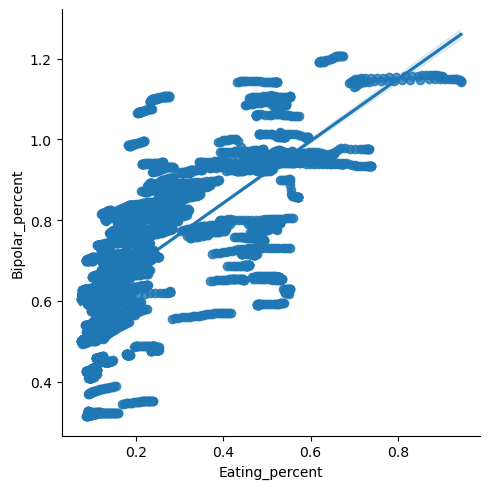

In [20]:
# Create scatterplot for eating disorder and bipolar columns in seaborn

sns.lmplot(x = 'Eating_percent', y = 'Bipolar_percent', data = df)

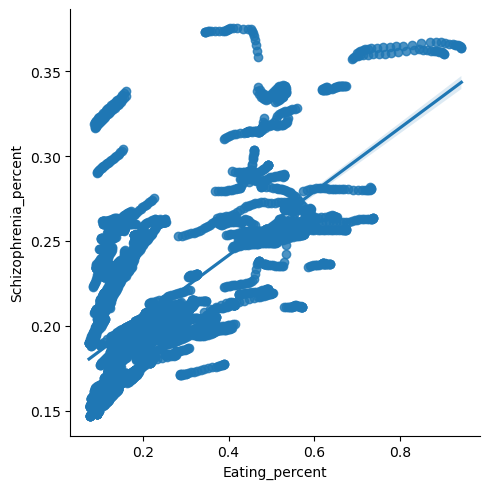

In [21]:
# Create scatterplot for eating disorder and schizophrenia columns in seaborn

sns.lmplot(x = 'Eating_percent', y = 'Schizophrenia_percent', data = df)

INSIGHTS: These three plots are similar in shape and layout. Data points seem to be clustered closer to the line of best fit for eating disorders and bipolar disorder. Few outliers exist in any of the three graphs, but distribution is slightly more even when looking at the bipolar version. It seems like eating disorders share a similar prevalence with all three other illnesses.

05 Create Pair Plot for Full Dataset

In [24]:
# Create a subset excluding irrelevant columns
#get list of columns for reference

df.columns

Index(['Entity', 'Code', 'Year', 'Country, Year', 'Schizophrenia_percent',
       'Bipolar_percent', 'Eating_percent', 'Anxiety_percent', 'Drug_percent',
       'Depression_percent', 'Alcohol_percent', 'All Ages', 'Age 10-14',
       'Age 15-19', 'Age 20-24', 'Age 25-29', 'Age 30-34', 'Age 50-69',
       'Age 70+', 'Age 15-49', 'Age Standardized', 'Males_percent',
       'Females_percent', 'Population', 'Suicide_deaths_per_100K',
       'Depression_per_100K', 'Number with depression'],
      dtype='object')

In [25]:
#exclude Code column

sub = df[['Entity', 'Year', 'Country, Year', 'Schizophrenia_percent',
       'Bipolar_percent', 'Eating_percent', 'Anxiety_percent', 'Drug_percent',
       'Depression_percent', 'Alcohol_percent', 'All Ages', 'Age 10-14',
       'Age 15-19', 'Age 20-24', 'Age 25-29', 'Age 30-34', 'Age 50-69',
       'Age 70+', 'Age 15-49', 'Age Standardized', 'Males_percent',
       'Females_percent', 'Population', 'Suicide_deaths_per_100K',
       'Depression_per_100K', 'Number with depression']]

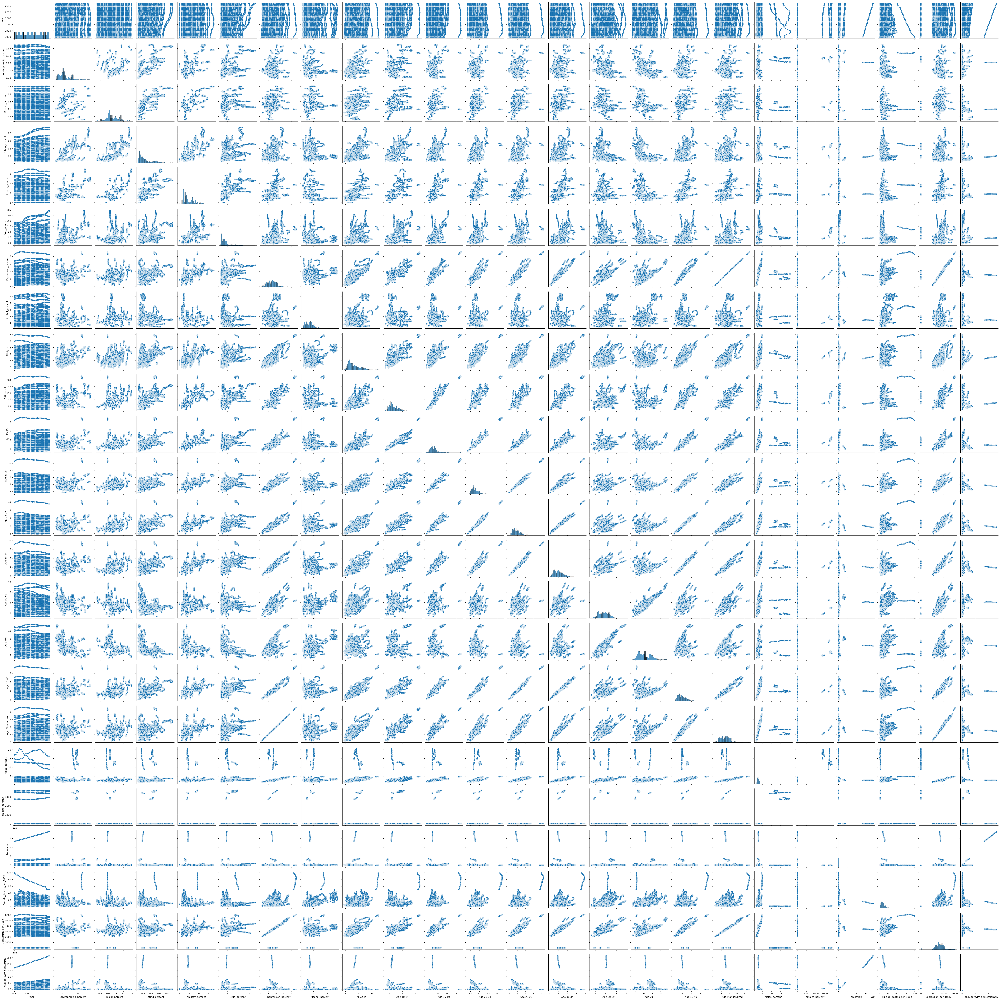

In [26]:
#create pair plot for full data set

g = sns.pairplot(sub)

In [27]:
# Create smaller sets of pair plots for readability
#Create pair plots for ages and mental illnesses

sub_2 = df[['Schizophrenia_percent',
       'Bipolar_percent', 'Eating_percent', 'Anxiety_percent', 'Drug_percent',
       'Depression_percent', 'Alcohol_percent', 'All Ages', 'Age 10-14',
       'Age 15-19', 'Age 20-24', 'Age 25-29', 'Age 30-34', 'Age 50-69',
       'Age 70+', 'Age 15-49']]

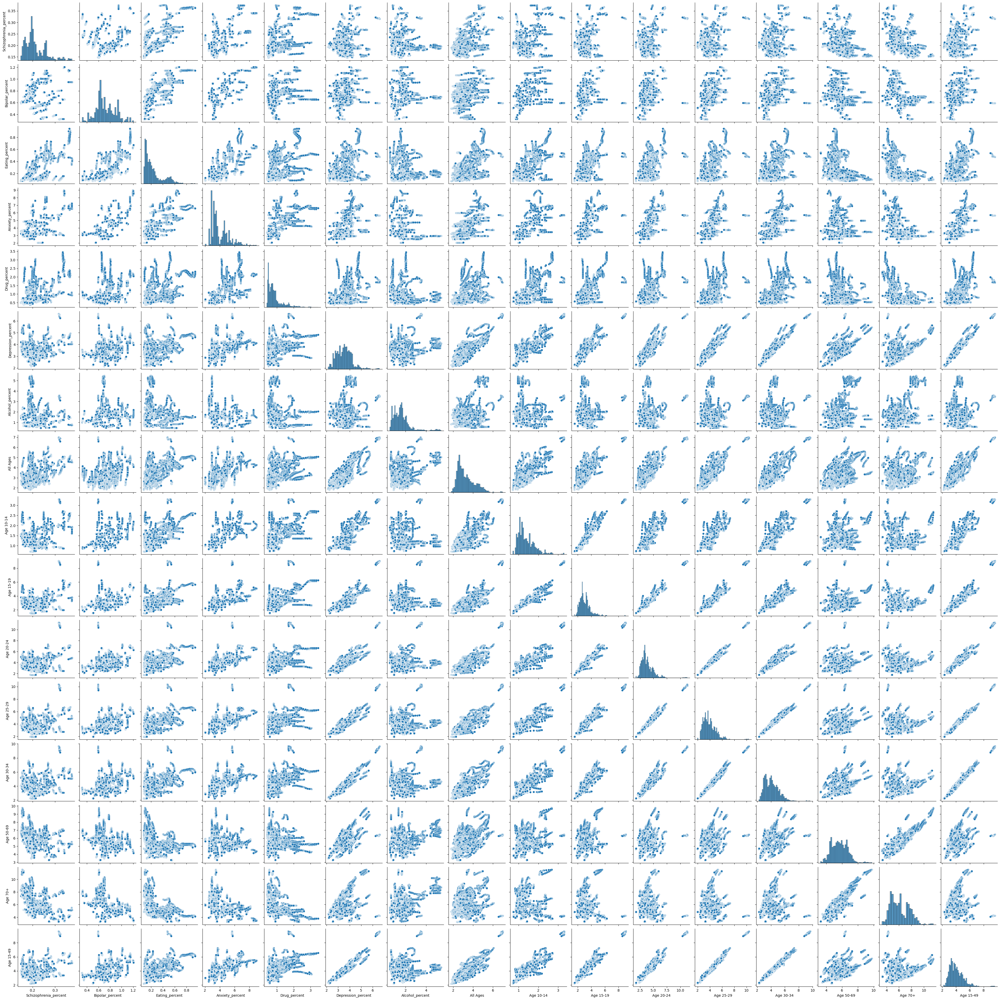

In [28]:
#create pair plot for sub_2

g = sns.pairplot(sub_2)

Here I'm looking at the relationships between mental illness rates and depression in certain age groups. This is a difficult data set to correlate because the data all relates back to illness prevalence. For example, does a low rate of depression in age group X also go along with a low rate of other mental illnesses? What I see is low and high rates of mental illnesses within the context of lower depression rates. 

In [30]:
#Create sub for gender, suicide rates, population, and mental illnesses

sub_3 = df[['Entity', 'Year', 'Country, Year', 'Schizophrenia_percent',
       'Bipolar_percent', 'Eating_percent', 'Anxiety_percent', 'Drug_percent',
       'Depression_percent', 'Alcohol_percent','Males_percent',
       'Females_percent', 'Population', 'Suicide_deaths_per_100K',
       'Depression_per_100K', 'Number with depression']]

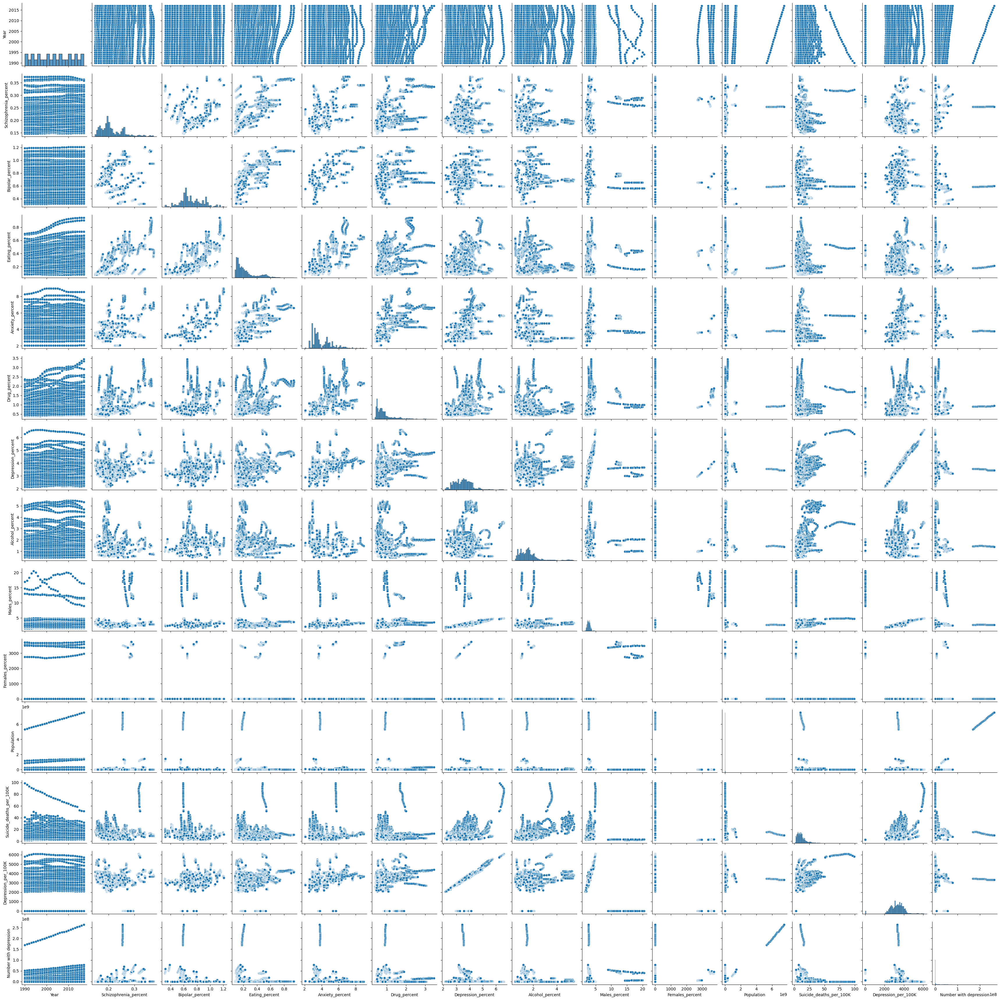

In [31]:
#create pair plot for sub_3

g = sns.pairplot(sub_3)

INSIGHT: Here I see some increases in depression and population, and a decrease in suicide rates per year. The graphs for population and number of people with depression are interestingly shaped, with a line of high outliers around the 2% to 4% mark. That might be worth looking into, but I'm not sure comparing percent with depression to percent with depression/other illness is going to be useful. Input would be welcome here.

06 Create Categorical Plot

<Axes: xlabel='Depression_per_100K', ylabel='Count'>

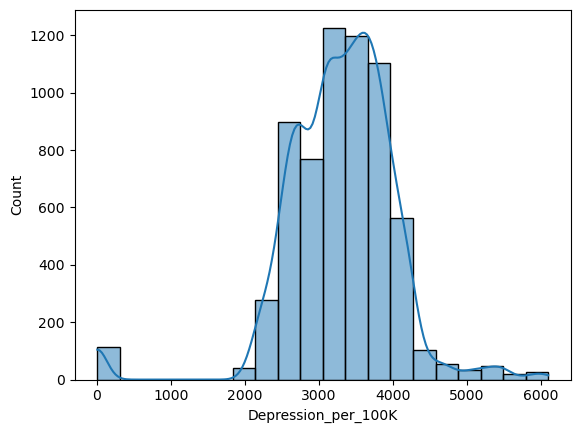

In [34]:
# Use a histogram to visualize the distribution of key variable

sns.histplot(df['Depression_per_100K'], bins = 20, kde = True)

In [35]:
#split results into 3 categories
df.loc[df['Depression_per_100K'] <= 2500, 'Depression prevalence'] = 'Low incidence'

In [36]:
df.loc[(df['Depression_per_100K'] > 2500) & (df['Depression_per_100K'] < 4000), 'Depression prevalence'] = 'Moderate incidence'

In [37]:
df.loc[df['Depression_per_100K'] >= 4000, 'Depression prevalence'] = 'High incidence'

In [38]:
#check output
df['Depression prevalence'].value_counts(dropna = False)

Depression prevalence
Moderate incidence    5117
High incidence         764
Low incidence          587
Name: count, dtype: int64

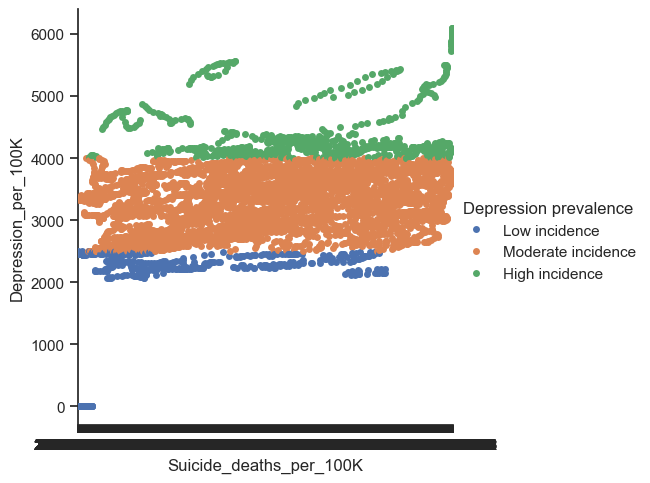

In [39]:
# Create a categorical plot for depression and eating disorders

sns.set(style="ticks")
g = sns.catplot(x="Suicide_deaths_per_100K", y="Depression_per_100K", hue="Depression prevalence", data=df)

INSIGHT: Low incidence of depression is more likely with low rates of suicide. There are multiple high outliers where suicide rates are the highest.

07 Answers to Exploration Questions

Key Question #1: Which other mental illnesses have the strongest correlation with depression?

Answer: Pair map shows a potential connection between drug dependence disorders and percentage. However, the connections are stronger with eating disorders and other mental illnesses, specifically anxiety, bipolar disorder, and schizophrenia.

Key Question #2: Do high suicide rates coordinate with higher rates of depression?

Answer: High incidences of depression are more common when suicide deaths are highest. Low depression rates are much less common in those situations as well. However, there is no uptick trend in depression as suicide rates climb.

08 Develop Preliminary Hypotheses and Export File

Research hypothesis #1: If a country has a high incidence of eating disorders, it will also have a high rate of other mental illnesses.

Research hypothesis #2:If a country records a high volume of suicide deaths, it is more likely to have high rates of depression.

In [47]:
#check dataframe for output
df.head()

,Entity,Code,Year,"Country, Year",Schizophrenia_percent,Bipolar_percent,Eating_percent,Anxiety_percent,Drug_percent,Depression_percent,...,Age 70+,Age 15-49,Age Standardized,Males_percent,Females_percent,Population,Suicide_deaths_per_100K,Depression_per_100K,Number with depression,Depression prevalence
0,Afghanistan,AFG,1990,"Afghanistan, 1990",0.160560,0.697779,0.101855,4.828830,1.677082,4.071831,...,5.202803,4.939766,4.071831,3.499982,4.647815,12412000,10.318504,4039.755763,318435.8137,High incidence
1,Afghanistan,AFG,1991,"Afghanistan, 1991",0.160312,0.697961,0.099313,4.829740,1.684746,4.079531,...,5.192849,4.902682,4.079531,3.503947,4.655772,13299000,10.327010,4046.256034,329044.7740,High incidence
2,Afghanistan,AFG,1992,"Afghanistan, 1992",0.160135,0.698107,0.096692,4.831108,1.694334,4.088358,...,5.176872,4.837097,4.088358,3.508912,4.662066,14486000,10.271411,4053.709902,382544.5729,High incidence
3,Afghanistan,AFG,1993,"Afghanistan, 1993",0.160037,0.698257,0.094336,4.830864,1.705320,4.096190,...,5.167355,4.813657,4.096190,3.513429,4.669012,15817000,10.376123,4060.203474,440381.5074,High incidence
4,Afghanistan,AFG,1994,"Afghanistan, 1994",0.160022,0.698469,0.092439,4.829423,1.716069,4.099582,...,5.157549,4.839340,4.099582,3.515578,4.673050,17076000,10.575915,4062.290365,456916.6455,High incidence


In [48]:
df.to_csv(os.path.join(path, 'Cleaned_data.csv'))